# Notebook for plotting gene pairs in Van Rooij, MAYO and Miller(GSE) datasets

In [1]:
import os
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from skrebate import ReliefF
from mlxtend.feature_selection import SequentialFeatureSelector as SFS

from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import LabelEncoder
from tqdm import tqdm
from itertools import combinations

sns.set_theme(style='white', font_scale=1.8)

plt.rcParams['figure.figsize'] = (5, 5)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 12
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['figure.autolayout'] = True

In [7]:
# genes_VR = pd.read_csv('../Output/genes_VR.csv', header=None)[0].values
df_normalized_VR = pd.read_csv('../Output/df_normalized_VR.csv', index_col=0)
labels_VR = pd.read_csv('../Output/labels_VR.csv', header=None)[0].values

In [8]:
labels_VR

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [9]:
df_normalized_VR['A2M']

CASE_01    0.262498
CASE_03    0.207228
CASE_04   -0.678589
CASE_05   -0.350041
CASE_06    0.158835
CASE_07    2.690606
CASE_08    0.201006
CASE_09    0.580778
CASE_10    0.383476
CASE_11   -0.591298
CASE_12   -0.908015
CASE_13   -0.355514
CASE_14    0.581478
CASE_16   -0.269351
CASE_17    2.007524
CASE_18    1.583588
CASE_19    0.234299
CASE_20   -0.817529
CTRL_01   -1.399274
CTRL_02   -1.281718
CTRL_03   -0.723071
CTRL_04   -1.044768
CTRL_05   -0.087571
CTRL_06   -1.054223
CTRL_07    0.296129
CTRL_08   -0.412327
CTRL_09    1.542440
CTRL_10   -0.756594
Name: A2M, dtype: float64

In [5]:
df_normalized_VR

,A2M,A2ML1,A4GALT,AAAS,AACS,AADAT,AAED1,AAGAB,AAK1,AAMDC,...,ZSWIM8,ZUFSP,ZW10,ZWILCH,ZWINT,ZXDC,ZYG11B,ZYX,ZZEF1,ZZZ3
CASE_01,0.262498,-0.400548,1.813251,1.881712,-1.140225,-0.920810,0.482868,-0.813459,-0.747251,0.989902,...,-1.079191,0.134013,-0.358608,-0.631922,0.140609,0.968067,-1.200347,0.945465,-1.365422,-0.755397
CASE_03,0.207228,-1.012084,0.822480,0.200400,-1.215069,-0.796119,1.034377,-1.009918,-0.807624,-0.292057,...,0.743802,0.117165,0.463107,-1.083317,-1.456404,0.528195,-0.185151,-0.232692,1.721934,1.054001
CASE_04,-0.678589,-0.419777,0.255154,0.099219,-0.773538,-1.324087,0.349550,-0.416591,-0.838941,-1.075643,...,0.753153,0.001561,-0.869690,-0.600363,-1.036370,1.533280,0.152054,-0.161703,-0.760876,0.265080
CASE_05,-0.350041,1.974697,-0.614994,-0.323851,0.288811,-0.287122,0.074056,0.375268,0.277486,0.215311,...,0.224254,-0.458300,-0.433101,-0.197944,0.369549,0.232866,0.281181,-0.813602,1.381503,-0.600216
CASE_06,0.158835,-0.385697,0.322438,-0.537436,-0.692208,-0.481859,0.088242,-0.536354,-0.562545,-0.891392,...,0.983801,-0.757220,0.548534,-0.157262,-0.924477,1.993962,0.529370,-0.253990,-0.423664,1.816990
CASE_07,2.690606,-0.440483,1.360049,0.774954,-1.597867,-0.983397,2.401742,-0.478094,-0.764594,0.613003,...,2.125411,0.554326,1.467721,-1.085234,-1.047566,0.202255,-0.118956,3.141378,1.971559,1.618774
CASE_08,0.201006,0.367343,-0.052194,0.126239,-0.471286,0.139912,0.070766,-1.076391,-0.521416,-1.179357,...,-0.192567,-0.783364,-0.085462,-0.477974,0.241716,0.114410,-0.653155,0.405010,-0.250265,0.113871
CASE_09,0.580778,0.015983,2.932433,0.053009,-0.573578,0.149075,1.482101,-0.712097,-0.919003,1.091663,...,0.477888,-0.671663,-1.664906,-0.222665,1.209362,1.083649,-1.155641,1.308395,0.288617,-0.429790
CASE_10,0.383476,1.442074,-0.196241,-0.115060,-0.275082,-0.968285,0.517211,-0.300231,-0.531284,-0.717826,...,1.336023,-0.842022,0.586887,0.483457,-0.476514,1.723996,0.369372,0.121951,0.945969,1.451011
CASE_11,-0.591298,0.116326,0.902357,-0.044505,-0.696229,-0.059159,1.118761,-0.492903,-0.721702,-0.461351,...,0.768668,0.577577,-1.238433,0.483127,0.006145,-0.569637,0.122221,1.611976,0.829143,0.835937


## Plotting figures

In [6]:
def plot_pair_SVM(pair, df, labels, path=None, show=False):
    df_to_plot = df[pair]
    # Plot using matplotlib.pyplot
    plt.figure()
    x = df_to_plot[pair[0]].values
    y = df_to_plot[pair[1]].values
    plt.plot(x[labels ==0], y[labels ==0], 'bo', label = 'CN')
    plt.plot(x[labels ==1], y[labels ==1], 'r^', label = 'AD')
    # Train the classifier
    clf = SVC(kernel='linear', C=100, probability=True)
    clf.fit(df_to_plot.values, labels.ravel())
    # Create a mesh to plot in
    x_min, x_max = x.min() - 1, x.max() + 1
    y_min, y_max = y.min() - 1, y.max() + 1
    n_points = 1000
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, n_points),
                            np.linspace(y_min, y_max, n_points))
    plt.subplot(1, 1, 1)
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    plt.contourf(xx, yy, Z, cmap=plt.cm.coolwarm, alpha=0.3)
    plt.xlabel(pair[0])
    plt.ylabel(pair[1])
    # Compute score 
    scores = clf.score(df_to_plot.values, labels.ravel())
    # Title has the two genes and the score
    plt.title(' vs '.join(pair) + ' - score: ' + str(round(scores.mean(), 2)))
    plt.legend(loc = 'best', fontsize = 10)
    plt.ioff()
    if path: 
        # REMEMBER THAT None == False. If path is None, the figure is not saved.
        # plt.savefig(path, dpi =300, bbox_inches='tight', format='png', transparent = False)
        plt.savefig(path, dpi =300, format='png', transparent = False)
    return None

In [7]:
N_reliefF = 500

In [8]:
N_figures = 200

In [9]:
# pairs_to_plot_from_VR_to_VR = pd.read_csv('../Output/scores_VR_to_VR_'+str(N_reliefF)+'.csv').sort_values(by='cv_VR', ascending=False)
# pairs_to_plot_from_VR_to_VR[:N_figures].drop(['cv_VR','train_VR'], axis=1)

In [17]:
pairs_to_plot_from_VR = pd.read_excel('../Output/scores_fromVR_'+str(N_reliefF)+'.xlsx', sheet_name='Threshold_0.7')
pairs_to_plot_from_VR[:N_figures].drop(['cv_VR','train_VR','cv_MAYO','train_MAYO','cv_GSE','train_GSE'], axis=1)
pairs_to_plot_from_VR = pairs_to_plot_from_VR.loc[:, ['Gene 1', 'Gene 2']]

c:\Users\fetsuruk\AppData\Local\anaconda3\envs\AD\Lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():
c:\Users\fetsuruk\AppData\Local\anaconda3\envs\AD\Lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Conditional Formatting extension is not supported and will be removed
  for idx, row in parser.parse():


In [18]:
pairs_to_plot_from_VR

,Gene 1,Gene 2
0,VGF,STARD7
1,SCG3,KCNA6
2,SST,GEM
3,TRIB1,STARD7
4,DDOST,STARD7
...,...,...
3423,IDH2,CDC26
3424,OR2L13,MARCKSL1
3425,KIF6,MARCKSL1
3426,MARCKSL1,CIRBP


 10%|█         | 20/200 [00:21<03:10,  1.06s/it]C:\Users\fetsuruk\AppData\Local\Temp\ipykernel_53952\2831374393.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()
100%|██████████| 200/200 [03:40<00:00,  1.10s/it]


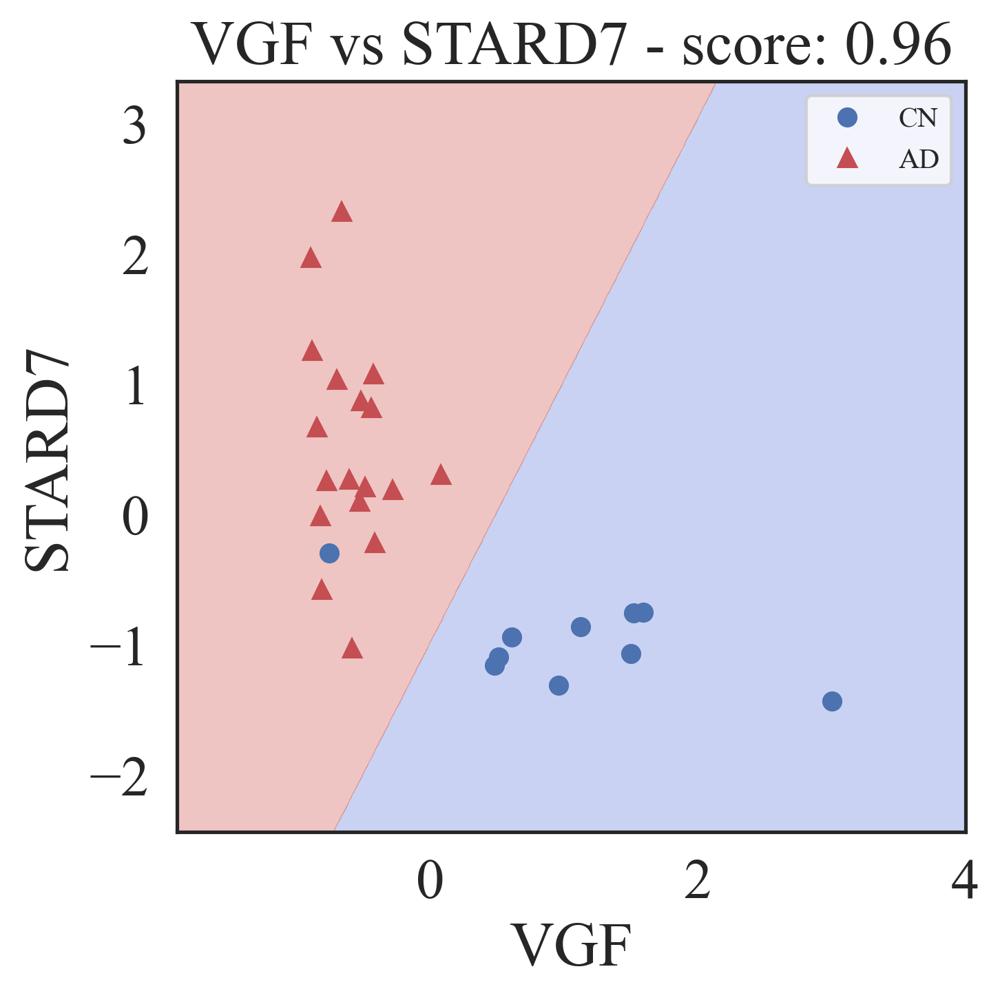

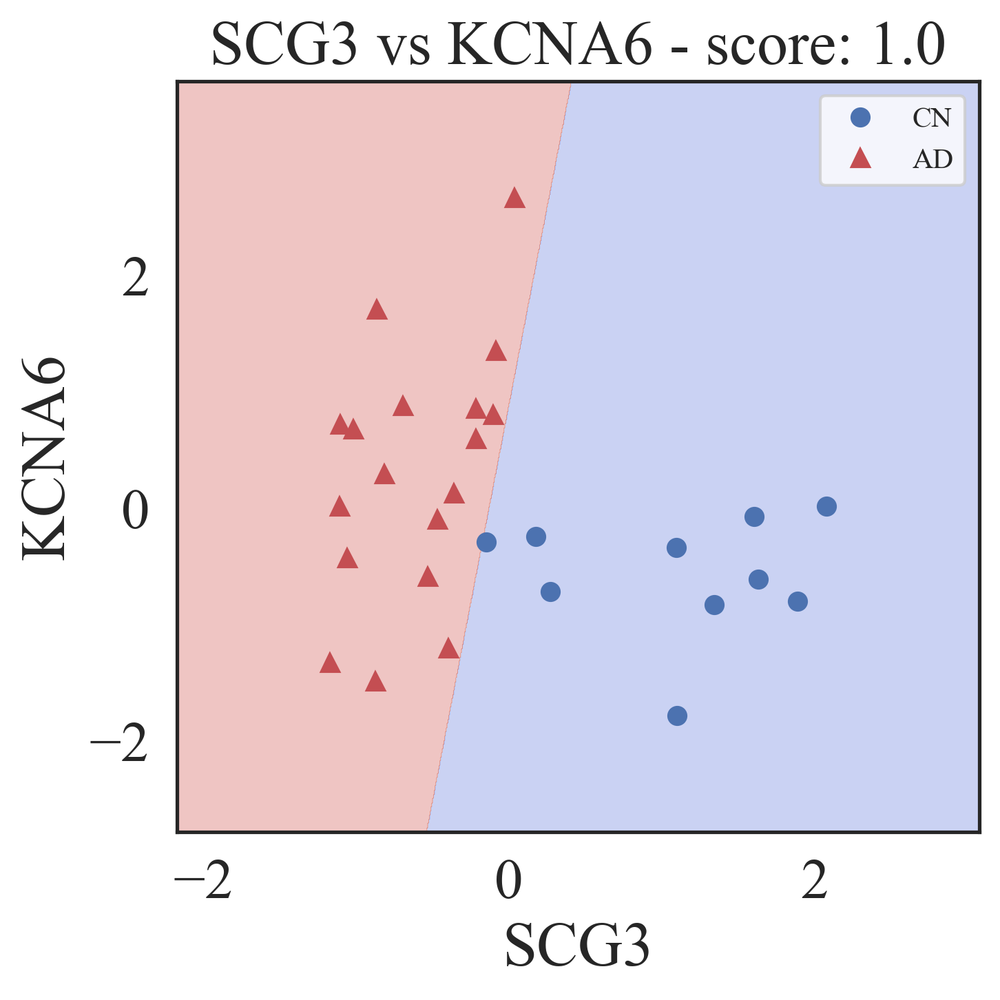

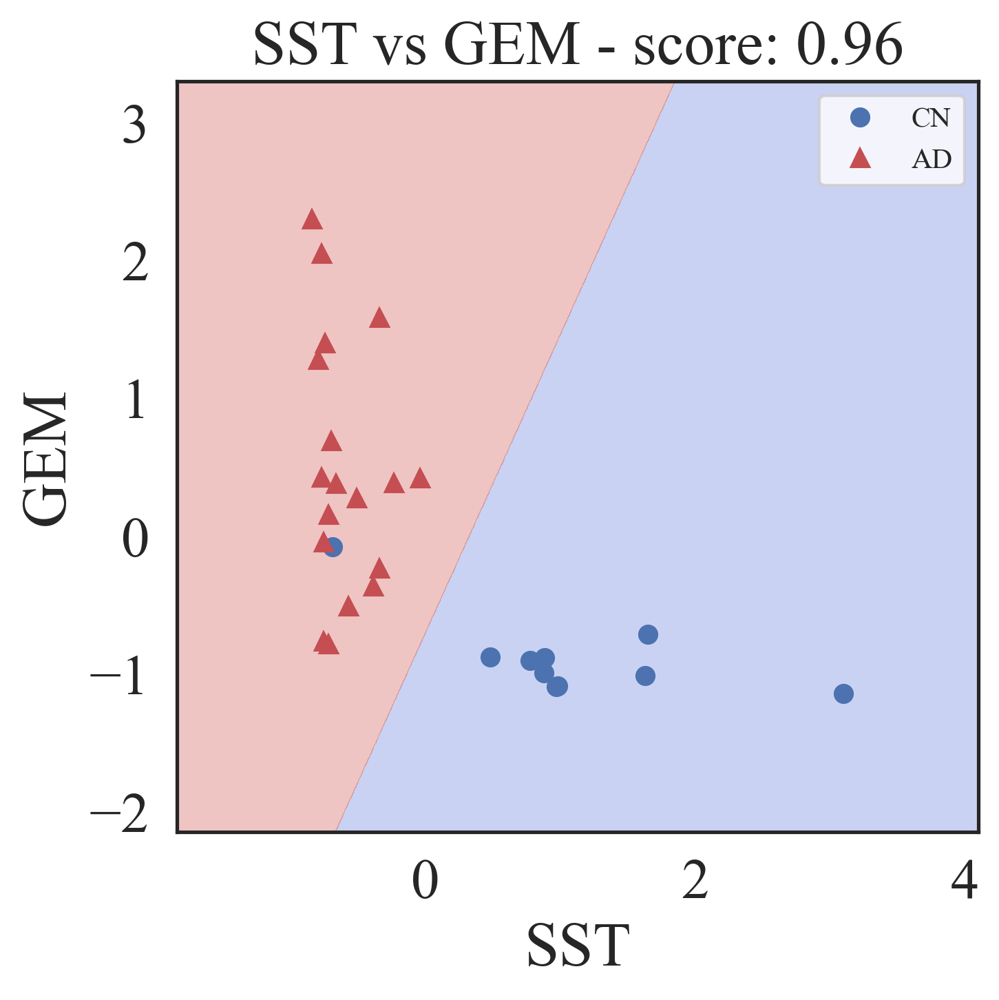

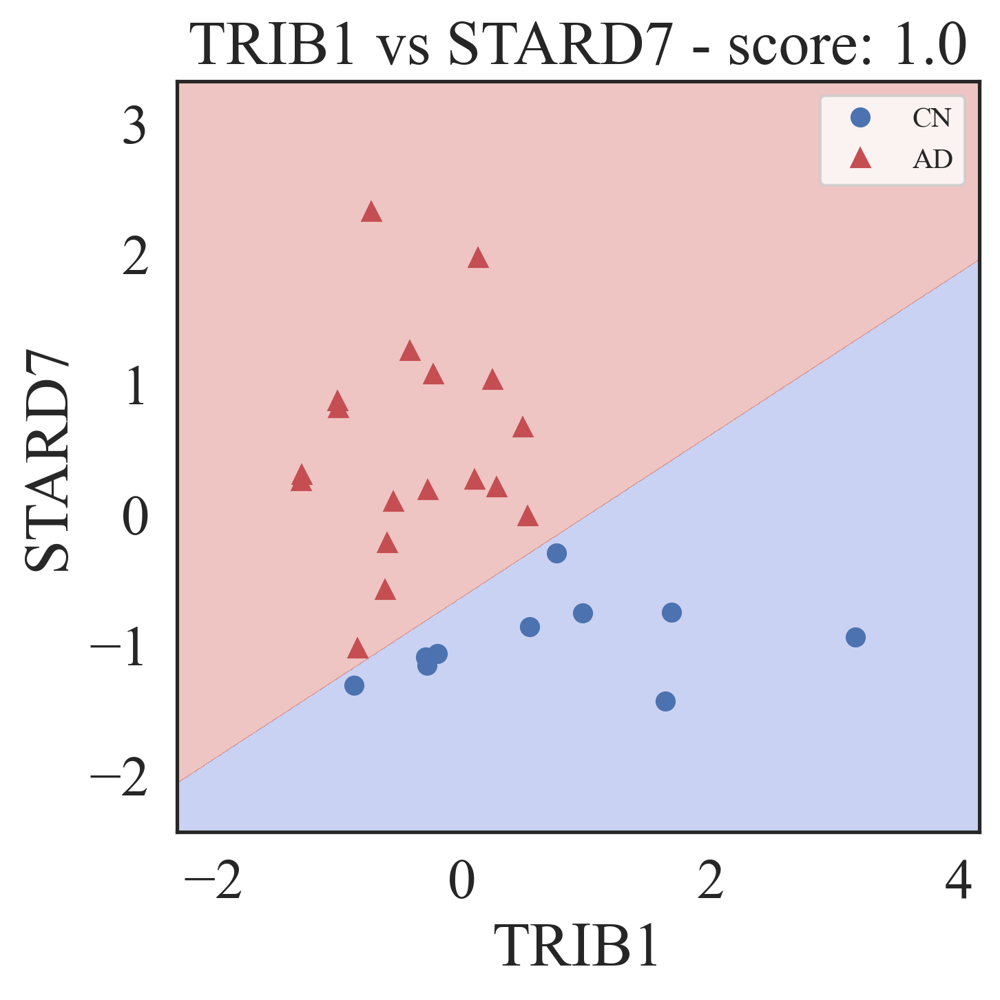

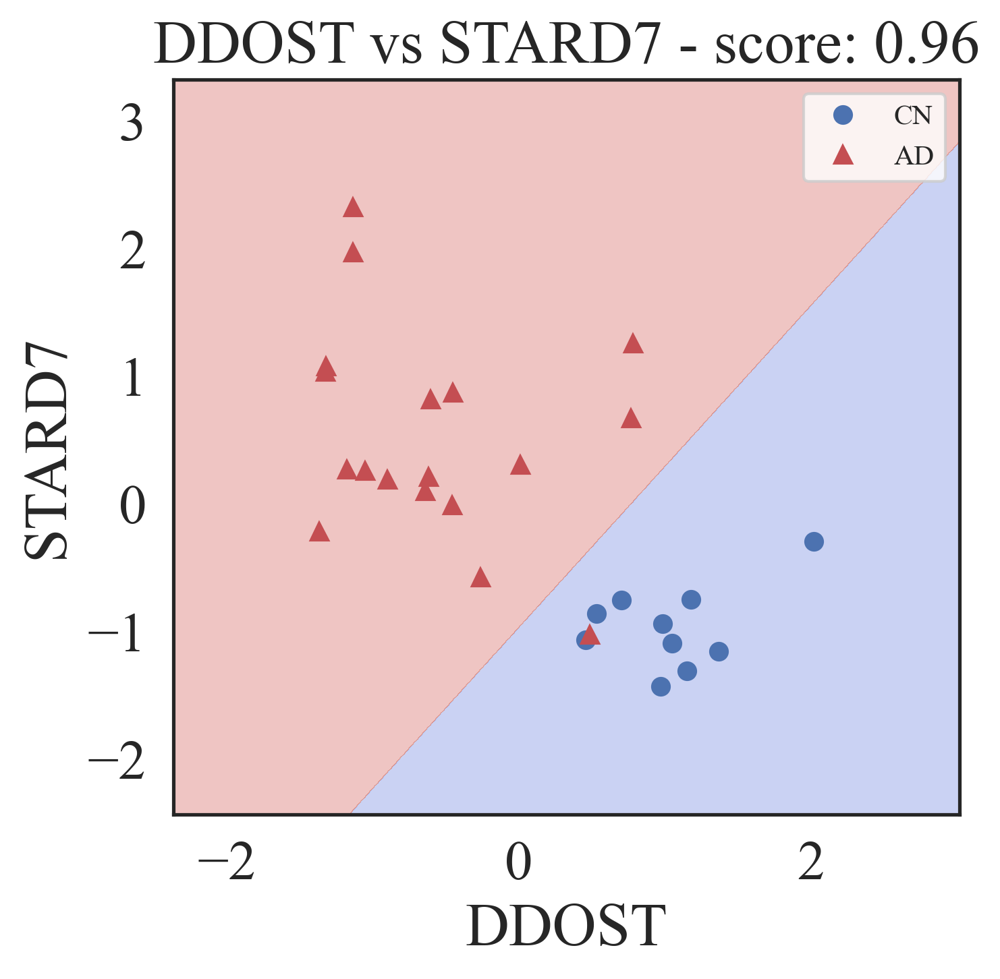

...

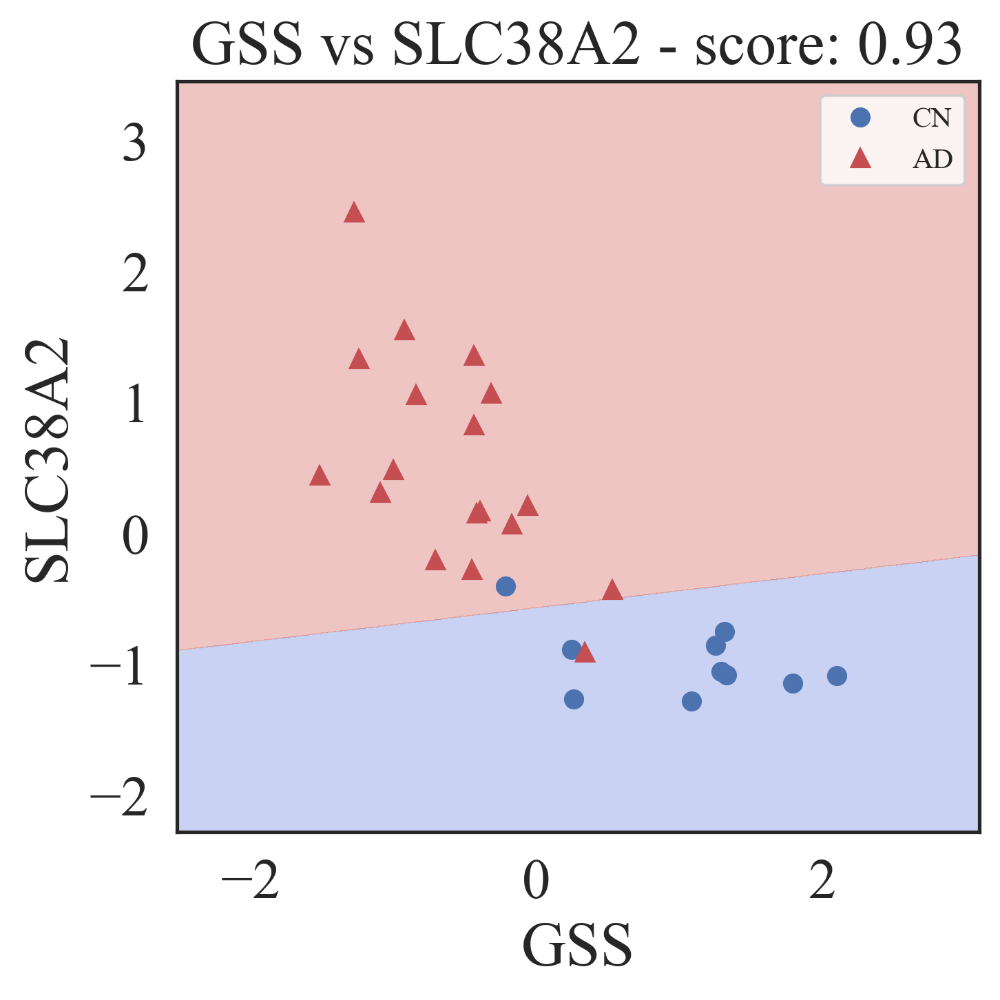

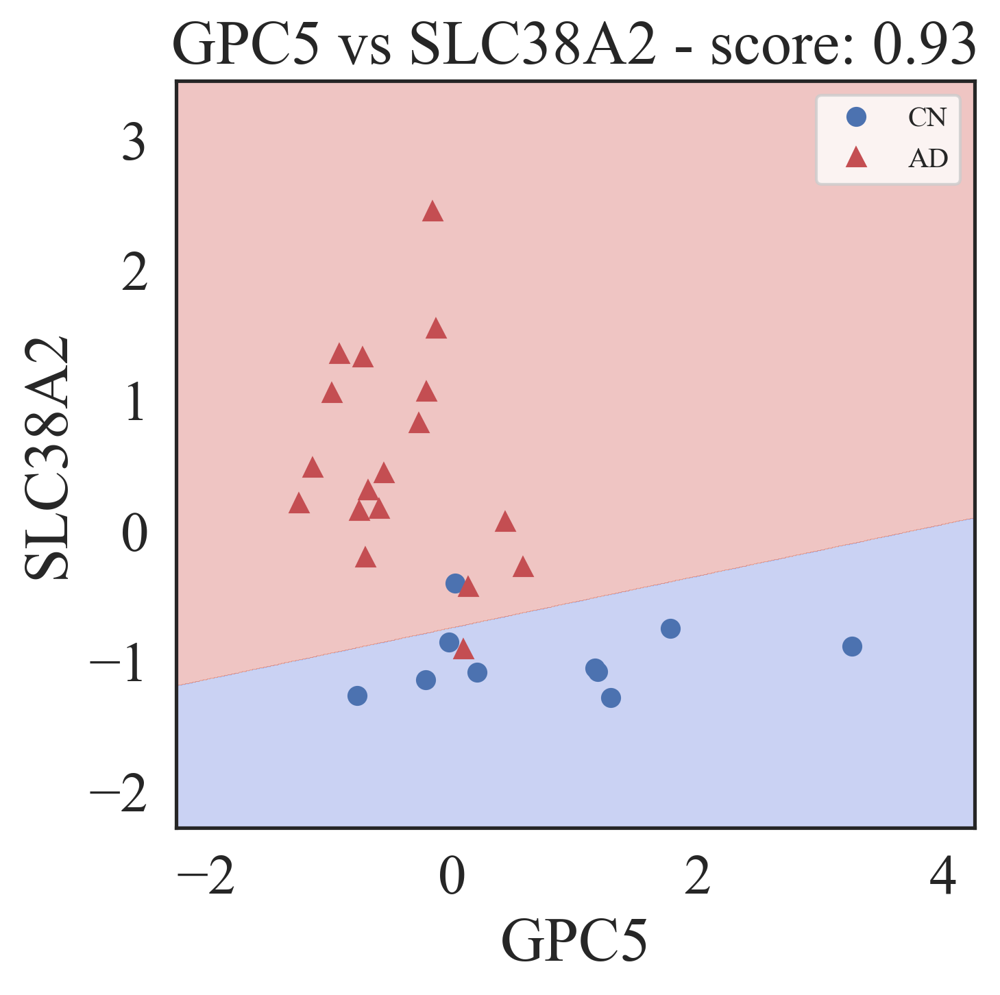

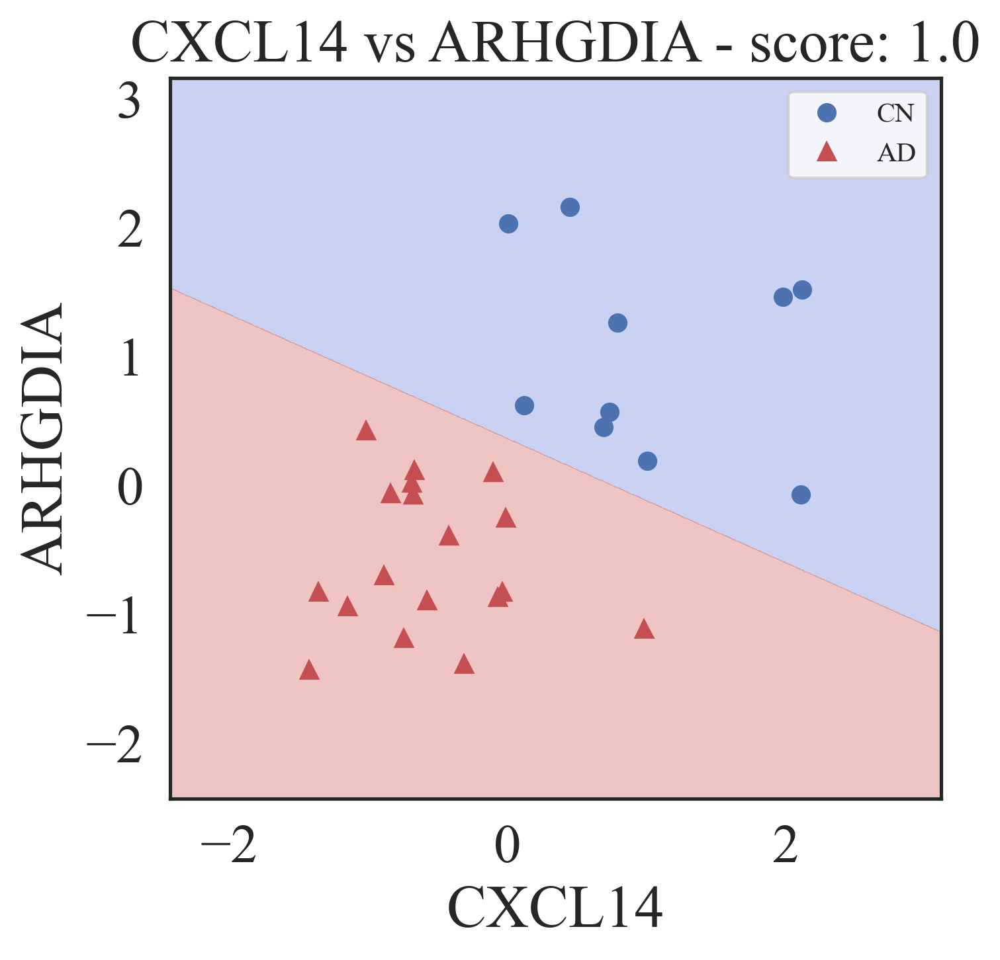

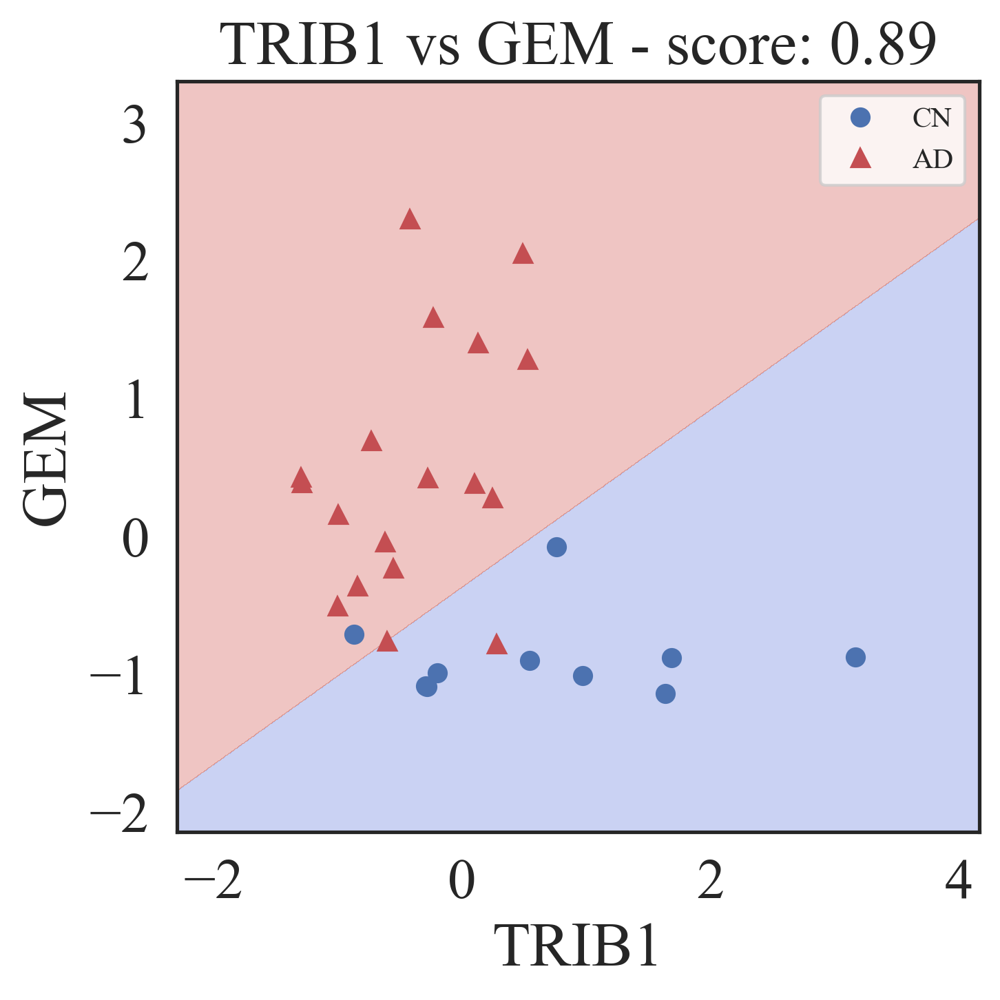

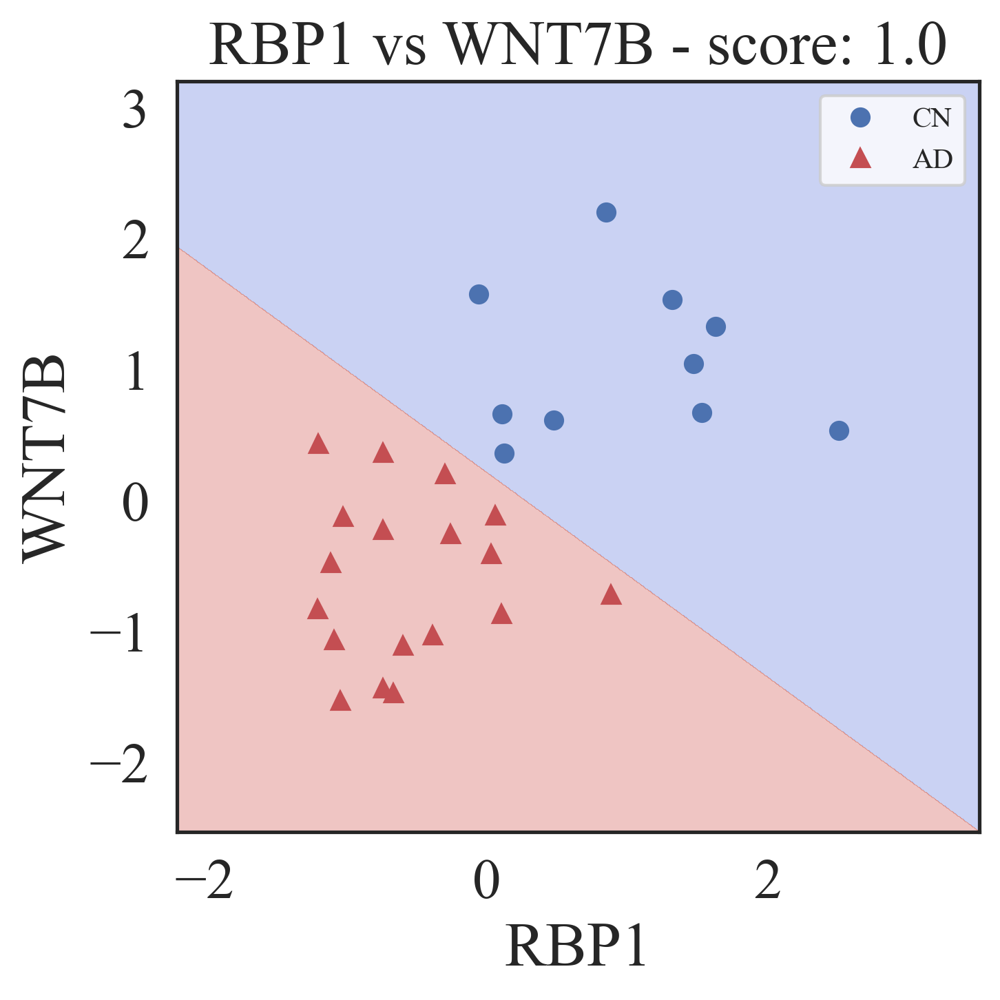

In [19]:
if not os.path.exists('../figures/FINAL/bivariate/fromVR/VR/'):
   os.makedirs('../figures/FINAL/bivariate/fromVR/VR/')
for i, pair in enumerate( tqdm(pairs_to_plot_from_VR[:N_figures].values.tolist()) ):
   if set(pair).issubset(genes_VR):
      plot_pair_SVM(pair, df_normalized_VR, labels_VR, path = '../figures/FINAL/bivariate/fromVR/VR/' + str(i+1) + '_' + '_'.join(pair) + '.png', show=False)

In [20]:
if not os.path.exists('../figures/FINAL/bivariate/fromVR/MAYO/'):
   os.makedirs('../figures/FINAL/bivariate/fromVR/MAYO/')
for i, pair in enumerate( tqdm(pairs_to_plot_from_VR[:N_figures].values.tolist()) ):
   if set(pair).issubset(genes_MAYO):
      plot_pair_SVM(pair, df_normalized_MAYO, labels_MAYO, path = '../figures/FINAL/bivariate/fromVR/MAYO/' + str(i+1) + '_' + '_'.join(pair) + '.png', show=False)

 10%|█         | 20/200 [00:28<04:23,  1.46s/it]C:\Users\fetsuruk\AppData\Local\Temp\ipykernel_53952\2831374393.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()
100%|██████████| 200/200 [04:51<00:00,  1.46s/it]


In [21]:
if not os.path.exists('../figures/FINAL/bivariate/fromVR/GSE/'):
   os.makedirs('../figures/FINAL/bivariate/fromVR/GSE/')
for i, pair in enumerate( tqdm(pairs_to_plot_from_VR[:N_figures].values.tolist()) ):
   if set(pair).issubset(genes_GSE):
      plot_pair_SVM(pair, df_normalized_GSE, labels_GSE, path = '../figures/FINAL/bivariate/fromVR/GSE/' + str(i+1) + '_' + '_'.join(pair) + '.png', show=False)

100%|██████████| 200/200 [04:54<00:00,  1.47s/it]


In [44]:
pairs_to_plot_from_VR_to_MAYO = pd.read_csv('../Output/scores_VR_to_MAYO_'+str(N_reliefF)+'.csv').sort_values(by='cv_MAYO', ascending=False)
pairs_to_plot_from_VR_to_MAYO[:N_figures].drop(['cv_MAYO','train_MAYO'], axis=1)

,Gene 1,Gene 2
22478,BCL6,TUBB2B
93425,GSTA4,ZNF652
46340,GTF2H3,ZNF652
18980,MED29,ZNF652
104888,ZNF652,CHMP4B
...,...,...
3128,WIF1,PRSS35
4252,SLC1A4,NFKBIA
38820,SST,KCNA6
69109,IDH2,SAP30L


In [45]:
if not os.path.exists('../figures/FINAL/bivariate/fromVRtoMAYO/'):
   os.makedirs('../figures/FINAL/bivariate/fromVRtoMAYO/')
for i, pair in enumerate( tqdm(pairs_to_plot_from_VR_to_MAYO[:N_figures].drop(['cv_MAYO','train_MAYO'], axis=1).values.tolist()) ):
   if set(pair).issubset(genes_MAYO):
      plot_pair_SVM(pair, df_normalized_MAYO, labels_MAYO, path = '../figures/FINAL/bivariate/fromVRtoMAYO/' + str(i+1) + '_' + '_'.join(pair) + '.png', show=False)

100%|██████████| 200/200 [04:21<00:00,  1.31s/it]


In [46]:
pairs_to_plot_from_VR_to_GSE = pd.read_csv('../Output/scores_VR_to_GSE_'+str(N_reliefF)+'.csv').sort_values(by='cv_GSE', ascending=False)
pairs_to_plot_from_VR_to_GSE[:N_figures].drop(['cv_GSE','train_GSE'], axis=1)

,Gene 1,Gene 2
72744,GEM,ME1
72532,GEM,BPGM
36855,HAPLN1,GEM
72663,GEM,NIPSNAP1
72613,GEM,SGK223
...,...,...
72479,GEM,GPC5
105721,NCAN,SMARCA4
20066,CXCL14,C1QBP
19965,CXCL14,DIRC2


In [47]:
if not os.path.exists('../figures/FINAL/bivariate/fromVRtoGSE/'):
   os.makedirs('../figures/FINAL/bivariate/fromVRtoGSE/')
for i, pair in enumerate( tqdm(pairs_to_plot_from_VR_to_GSE[:N_figures].drop(['cv_GSE','train_GSE'], axis=1).values.tolist()) ):
   if set(pair).issubset(genes_GSE):
      plot_pair_SVM(pair, df_normalized_GSE, labels_GSE, path = '../figures/FINAL/bivariate/fromVRtoGSE/' + str(i+1) + '_' + '_'.join(pair) + '.png', show=False)

100%|██████████| 200/200 [04:22<00:00,  1.31s/it]
